------
<h1>
    <center>
        Sentinel-2A Image Processing <br><br>Scenes of Interest from Ibadan, Illorin, and Kano, Nigeria<br>
    </center>
</h1>

------


The notebook presents the training data generation process.

### About Informal Settlement Dataset

The Informal Settlement Dataset is Urban Malaria Project (UMP) and was given access to in April, 2024. The dataset contains some "ground-validated" locations of informal population settlements across some selected wards from local government administratives of Ibadan, Illorin and Kano cities in Nigeria. Through visual interpretation, we want to generate ground-truth polygons of the informal settlements. This will will result in converting vector shapefiles to raster masks and thus generating the training dataframe.

### About Sentinel-2 Imagery

SENTINEL-2 is a wide-swath, high-resolution, multi-spectral imaging mission, supporting Copernicus Land Monitoring studies, including the monitoring of vegetation, soil and water cover, as well as observations of inland waterways and coastal areas ([Source](https://sentinel.esa.int/web/sentinel/user-guides/sentinel-2-msi/overview)). 

**Note**: We are looking for 2022-09-01 – 2023-01-31 satellite imagery from L-2A Sentinel-2 Imagery, hence, Sentinel-2A. 

## Imports of Required Packages and Setup

In [2]:
import os
import sys
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point

from skimage import exposure
import rioxarray as riox
import rasterio as rio

### Save the shapefiles of AOI for Satellite image extractions

In [29]:
# fname = "../data-out/shapefiles/S2_Agugu_2022-05-01_2022-06-30.tif"
fname = "../../../S2/S2_ibadan_2022-09-01_2022-12-31_file3.tif"
raster = rio.open(fname)
riox.open_rasterio(fname)

<xarray.DataArray (band: 11, y: 2148, x: 2779)>
[65662212 values with dtype=float32]
Coordinates:
  * band         (band) int64 1 2 3 4 5 6 7 8 9 10 11
  * x            (x) float64 3.762 3.762 3.762 3.762 ... 4.011 4.011 4.011 4.011
  * y            (y) float64 7.498 7.498 7.498 7.498 ... 7.305 7.305 7.305 7.305
    spatial_ref  int64 0
Attributes:
    AREA_OR_POINT:  Area
    scale_factor:   1.0
    add_offset:     0.0
    long_name:      ('B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', '...

In [6]:
### Sentinel 2 image processing level 1
def get_s2_processed_l1(filename):
    # # open image with rio
    raster = rio.open(filename)

    # Read the data
    data = raster.read()

    ### Change the axis from (band, x, y) to (x, y, band)
    data = np.transpose(data, (1, 2, 0))

    ## Preprocessing
    data_enhanced = np.zeros(data.shape)
    for i in range(data.shape[-1]):
        p2, p98 = np.percentile(data[:, :, i], (2, 98))
        data_enhanced[:, :, i] = exposure.rescale_intensity(data[:, :, i], in_range=(p2, p98))

    return raster, data, data_enhanced

In [30]:
raster, data, data_enhanced = get_s2_processed_l1(raster)

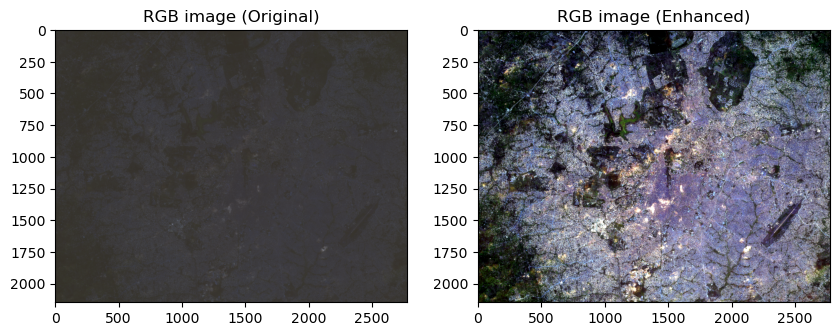

In [10]:
### Load and read rraster 
filename = "../../../S2/Ibadan-shp_geojs/S2_ibadan_2022-09-01_2022-12-31_file3.tif"
raster, data, data_enhanced = get_s2_processed_l1(filename)

### Plot imagery
fig,(ax1, ax2)= plt.subplots(1, 2, figsize=(10,5), dpi=100)
ax1.set_title("RGB image (Original)")
ax2.set_title("RGB image (Enhanced)")
ax1.imshow(data[:, :, 0:3])
ax2.imshow(data_enhanced[:, :, 0:3])
plt.show();

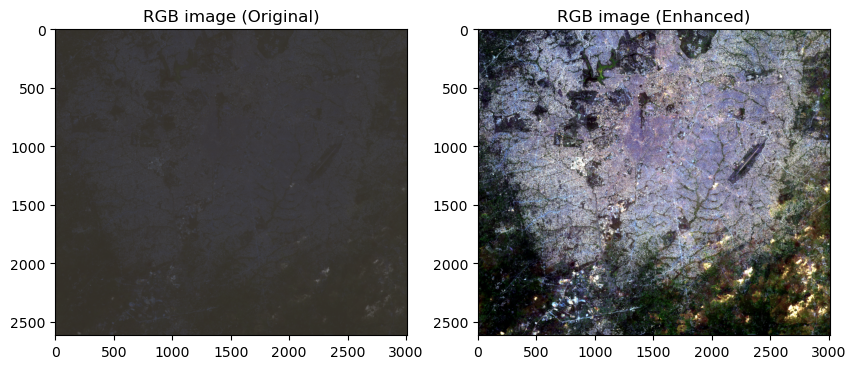

In [9]:
### Load and read rraster 
filename = "../../../S2/drive-download-20240509T155729Z-001/S2_Agugu_2022-09-01_2022-12-31.tif"
raster, data, data_enhanced = get_s2_processed_l1(filename)

### Plot imagery
fig,(ax1, ax2)= plt.subplots(1, 2, figsize=(10,5), dpi=100)
ax1.set_title("RGB image (Original)")
ax2.set_title("RGB image (Enhanced)")
ax1.imshow(data[:, :, 0:3])
ax2.imshow(data_enhanced[:, :, 0:3])
plt.show();

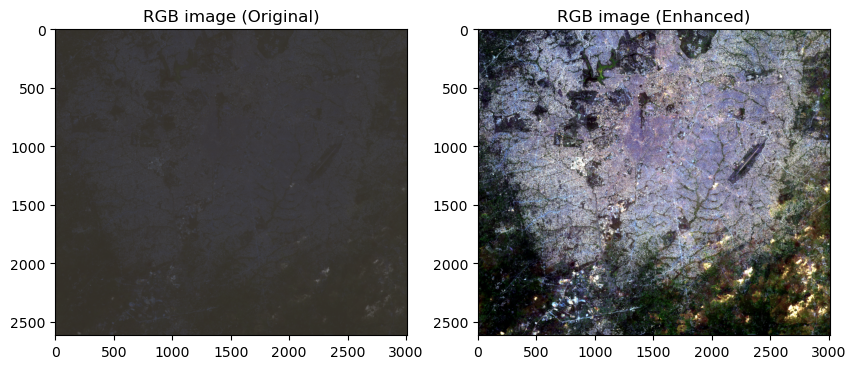

In [11]:
### Load and read rraster 
filename = "../../../S2/HR/S2_Agugu_2022-09-01_2022-12-31.tif"
raster, data, data_enhanced = get_s2_processed_l1(filename)

### Plot imagery
fig,(ax1, ax2)= plt.subplots(1, 2, figsize=(10,5), dpi=100)
ax1.set_title("RGB image (Original)")
ax2.set_title("RGB image (Enhanced)")
ax1.imshow(data[:, :, 0:3], cmap="terrain")
ax2.imshow(data_enhanced[:, :, 0:3], cmap="terrain")
plt.show();

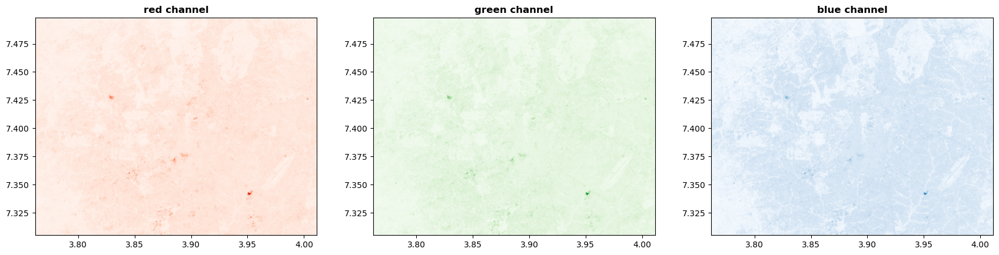

In [79]:
from rasterio.plot import show
fig, (axr, axg, axb) = plt.subplots(1, 3, figsize=(21, 7))
show((raster, 1), ax=axr, cmap='Reds', title='red channel')
show((raster, 2), ax=axg, cmap='Greens', title='green channel')
show((raster, 3), ax=axb, cmap='Blues', title='blue channel');


In [84]:
from rasterio.plot import show

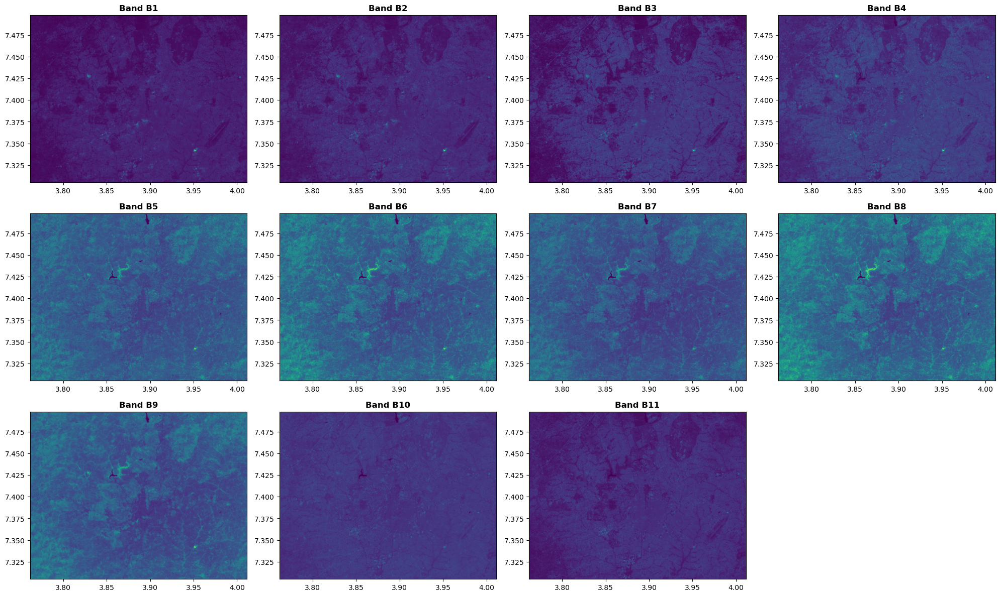

In [85]:

fig, ax = plt.subplots(3, 4, figsize=(20, 12))
ax = ax.reshape(-1)
for idx in range(11):
    show((raster, idx+1), ax=ax[idx], title=f'Band B{idx+1}')
ax[-1].set_axis_off()
fig.tight_layout();

In [1]:
### Load and read rraster 
filename = "../../../S2/Ibadan-shp_geojs/S2_ibadan_2022-09-01_2022-12-31_file4.tif"
raster, data, data_enhanced = get_s2_processed_l1(filename)

### Plot imagery
fig,(ax1, ax2)= plt.subplots(1, 2, figsize=(10,5), dpi=200)
ax1.set_title("RGB image (Original)")
ax2.set_title("RGB image (Enhanced)")
ax1.imshow(data[:, :, 0:3])
ax2.imshow(data_enhanced[:, :, 0:3])
plt.show();

NameError: name 'get_s2_processed_l1' is not defined

In [57]:
raster.meta

{'driver': 'GTiff',
 'dtype': 'float32',
 'nodata': None,
 'width': 2779,
 'height': 2148,
 'count': 11,
 'crs': CRS.from_epsg(4326),
 'transform': Affine(8.983152841195215e-05, 0.0, 3.761785083778908,
        0.0, -8.983152841195215e-05, 7.498058013488822)}

In [3]:
"""
Author: Laique Merlin Djeutchouang inspired from Debjani
"""
# Loading of the required packages
try:
    import sys
    import os
    import time
    from termcolor import colored
    import warnings
    from sklearn.cluster import MiniBatchKMeans
    from sklearn.exceptions import DataConversionWarning
    from sklearn.metrics import confusion_matrix
    from sklearn.metrics import classification_report, accuracy_score
    import rasterio as rio
    import numpy as np
    from typing import List, Tuple, Set, Dict, Any, Optional
    import pandas as pd
    from glob import glob
    import seaborn as sns
    import matplotlib as mpl
    import matplotlib.pyplot as plt
    from string import ascii_lowercase as asci
except ModuleNotFoundError:
    print('Module import error')
    sys.exit()
else:
    print(colored(
        '\nBingo!!! All libraries properly loaded. Ready to start!!!', 'green'), '\n')

# Disable all warnings
warnings.filterwarnings("ignore", message="numpy.dtype size changed")
warnings.filterwarnings("ignore", message="numpy.ufunc size changed")

# Warning used to notify implicit data conversions happening in the code.
warnings.filterwarnings(action='ignore', category=DataConversionWarning)
warnings.filterwarnings(action="ignore", category=UserWarning)
np.seterr(divide='ignore', invalid='ignore')


def find_max_shape(filenames: List[str]) -> Tuple[int, int]:
    """
    This function finds maximum shapes among all the filenames present in files (list).
    :param filenames: list of strings, each string contains the path of the image filenames.
    :return: maximum x shape and maximum y shape of an image.
    """
    max_x = 0
    max_y = 0
    for file in filenames:
        img = rio.open(file)
        img_data = img.read()
        max_x = max(max_x, img_data.shape[1])
        max_y = max(max_y, img_data.shape[2])

    return max_x, max_y


def process_train_data(filenames: List[str]) -> Tuple[np.ndarray, np.ndarray]:
    """
    This function takes all the images present in the files, finds maximum shapes along
    x and y direction from all the images, makes a numpy array of zeroes of the shape of
    [maximum_x, maximum_y]. Reads all the images present in the files and stack them one
    by one in the numpy array. Takes a square root of the numpy array and returns the array.
    :param filenames: list of strings, each string contains the path of the image filenames.
    :return: Containing the square root of the images (pixels) present in the filenames.
    """
    max_x, max_y = find_max_shape(filenames)
    train_array = np.zeros((len(filenames), max_x, max_y, 11))
    for i, filename in enumerate(filenames):
        img = rio.open(filename)
        img_data = img.read()
        img_data = np.transpose(img_data, axes = [1, 2, 0])
        train_array[i, 0:img_data.shape[0], 0:img_data.shape[1], :] = img_data
    train_array = np.sqrt(train_array)

    # Normalize the data array for training
    norm_train_array = normalize_data(train_array)

    return train_array, norm_train_array


def normalize_data(data: np.ndarray) -> np.ndarray:
    """
    Takes a numpy array and normalise it based on its min max values
    :param data: A Numpy array.
    :return: Normalised Numpy array.
    """
    min_array = data.min(axis=0).min(axis=0).min(axis=0)
    max_array = data.max(axis=0).max(axis=0).max(axis=0)
    norm_array = (data - min_array) / (max_array - min_array)

    return norm_array


def process_test_data(filename: str) -> np.ndarray:
    """
    Takes a numpy array and normalise it based on its min max values
    :param filename:
    :return: A normalised Numpy array
    """
    """
    :param data: A Numpy array
    :param min_array: A Numpy array
    :param max_array: A Numpy array
    :return: 
    """
    # Read the test image file and get its data
    img = rio.open(filename)
    img_data = img.read()
    img_data = np.transpose(img_data, axes=[1, 2, 0])
    img_data = np.sqrt(img_data)

    # Normalize data for testing
    min_array = img_data.min(axis=0).min(axis=0)
    max_array = img_data.max(axis=0).max(axis=0)
    norm_img_data = (img_data - min_array) / (max_array - min_array)

    return norm_img_data



Bingo!!! All libraries properly loaded. Ready to start!!! 



In [4]:
# Loading of the required packages
import matplotlib.pyplot as plt
import numpy as np
import rasterio as rio
from typing import List, Tuple


def plot_satellite_image(filename: str,
                         band_list: List[int],
                         fig_size: Tuple[int]=(6, 6)) -> None:
    """
    Creates image plots for 3 channels images.
    :param filename: path to the tif image file
    :param band_list: contains indices of bands to be used to create 3-channel images
    :param fig_size: contains dimensions of the 2D figure size
    """
    
    assert len(band_list) == 3, "Incorrect number of channels"
    img_data = rio.open(filename).read()
    img_data = np.transpose(img_data, axes=[1, 2, 0])
    rgb_img_data = img_data[:, :, band_list]
    rgb_img_data = np.sqrt(rgb_img_data)
    norm_rgb_img_data = normalize_data(rgb_img_data)

    fig, ax = plt.subplots(figsize=fig_size)
    ax.imshow(norm_rgb_img_data[:, :, [0, 1, 2]])
    ax.imshow(norm_rgb_img_data)
    plt.show()

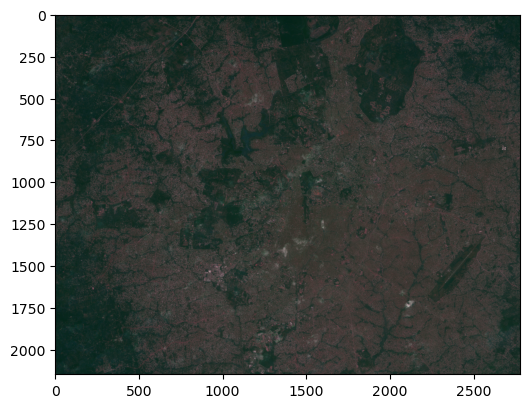

In [46]:

plot_satellite_image(filename = fname, band_list = [2, 0, 1])

In [79]:
from rasterio.plot import show

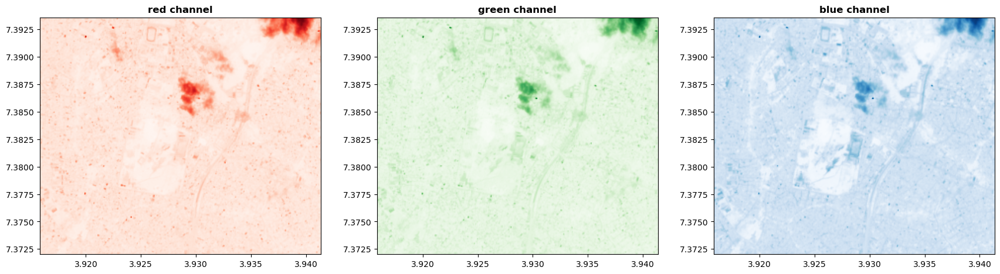

In [89]:
fig, (axr, axg, axb) = plt.subplots(1, 3, figsize=(21, 7))
show((src_raster1, 1), ax=axr, cmap='Reds', title='red channel')
show((src_raster1, 2), ax=axg, cmap='Greens', title='green channel')
show((src_raster1, 3), ax=axb, cmap='Blues', title='blue channel');


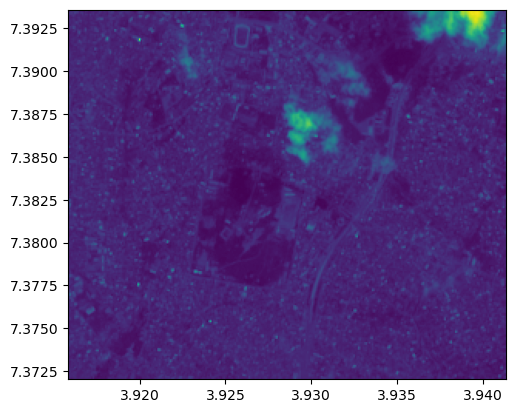

In [87]:
show(src_raster1.read(1), transform=src_raster1.transform, cmap='viridis');

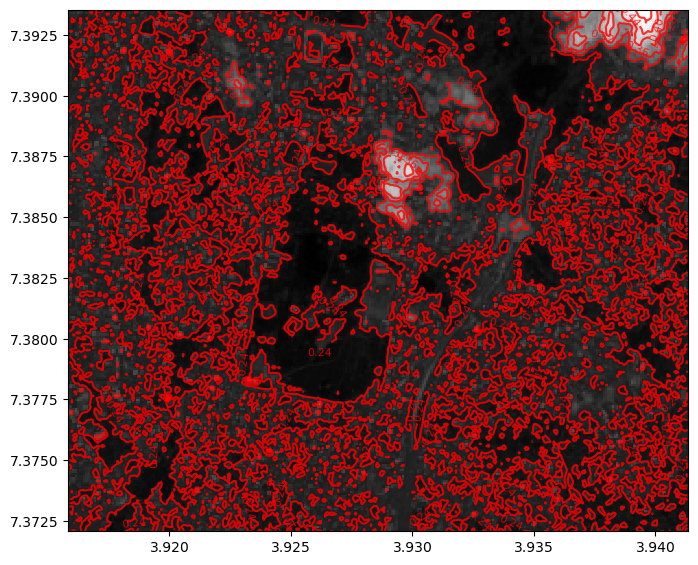

In [93]:
fig, ax = plt.subplots(1, figsize=(8, 8))
show((src_raster1, 1), cmap='Greys_r', interpolation='none', ax=ax)
show((src_raster1, 1), contour=True, ax=ax);

## GEE and Download of Sentinel-2 Data

In [1]:
# Import necessary libraries
import ee
import geemap


ModuleNotFoundError: No module named 'ee'

In [ ]:

# Authenticate and initialize Earth Engine
ee.Initialize()

# Define the region of interest (ROI) using a GeoJSON geometry
roi_geometry = ee.Geometry.Polygon(
    [[[longitude1, latitude1],
      [longitude2, latitude2],
      [longitude3, latitude3],
      [longitude4, latitude4],
      [longitude1, latitude1]]])

# Load Sentinel-2 image collection for the specified time and location
sentinel2 = (ee.ImageCollection('COPERNICUS/S2')
             .filterBounds(roi_geometry)
             .filterDate('2022-01-01', '2022-12-31')
             .sort('CLOUDY_PIXEL_PERCENTAGE')
             .first())

# Select relevant bands for analysis
bands = ['B4', 'B3', 'B2', 'B8']  # NIR, Red, Green, SWIR

# Calculate vegetation indices
ndvi = sentinel2.normalizedDifference(['B8', 'B4']).rename('NDVI')
mndwi = sentinel2.normalizedDifference(['B3', 'B11']).rename('MNDWI')

# Define thresholds for land cover classification
ndvi_thresholds = [0.2, 0.4, 0.6, 0.8]
mndwi_thresholds = [0.1, 0.2, 0.3]

# Land cover classification based on thresholds
vegetation = ndvi.gt(ndvi_thresholds[2])
water = mndwi.lt(mndwi_thresholds[1])
bare_ground = ndvi.lt(ndvi_thresholds[1]).And(mndwi.gt(mndwi_thresholds[0]))
urban = ndvi.lt(ndvi_thresholds[0])

# Display the land cover classification using folium
Map = geemap.Map()
Map.centerObject(roi_geometry, zoom=10)
Map.addLayer(vegetation, {'palette': '00FF00'}, 'Vegetation')
Map.addLayer(water, {'palette': '0000FF'}, 'Water')
Map.addLayer(bare_ground, {'palette': 'FFFF00'}, 'Bare Ground')
Map.addLayer(urban, {'palette': 'FF0000'}, 'Urban')
Map.addLayerControl()
Map

# Export the land cover classification to Google Drive
geemap.ee_export_image_to_drive(vegetation, description='vegetation', folder='land_cover', region=roi_geometry, scale=10)
geemap.ee_export_image_to_drive(water, description='water', folder='land_cover', region=roi_geometry, scale=10)
geemap.ee_export_image_to_drive(bare_ground, description='bare_ground', folder='land_cover', region=roi_geometry, scale=10)
geemap.ee_export_image_to_drive(urban, description='urban', folder='land_cover', region=roi_geometry, scale=10)


In [88]:
############### Data Access ###############

##### Raster file loader
def load_raster(input_file: str):
    """
    Returns a raster array which consists of its bands and
    transformation matrix parameters
    ----------
        input_file: str
            path directory to the raster file
    """
    with rio.open(input_file) as src:
        band = src.read()
        transform = src.transform
        crs = src.crs
        shape = src.shape
        profile = src.profile
        raster_img = np.rollaxis(band, 0, 1)

        output = {"band": band,
                  "raster_img": raster_img,
                  "transform": transform,
                  "crs": crs,
                  "shape": shape,
                  "profile": profile}

        return output

##### Raster file writer
def write_raster(raster, crs, transform, output_file):
    """
    Writes a raster array which consists of one band to the disc.
    ----------
        raster:
            raster array
        transform: 
            transformation matrix parameters
        output_file: str
            path directory to write the raster file
    """
    profile = {"driver": "GTiff",
               "compress": "lzw",
               "width": raster.shape[0],
               "height": raster.shape[1],
               "crs": crs,
               "transform": transform,
               "dtype": raster.dtype,
               "count": 1,
               "tiled": False,
               "interleave": 'band',
               "nodata": 0}

    profile.update(dtype=raster.dtype,
                   height=raster.shape[0],
                   width=raster.shape[1],
                   nodata=0,
                   compress="lzw")

    with rio.open(output_file, "w", **profile) as out:
        out.write_band(1, raster)



############### Spectral Indices (SIs) ###############

##### Normalized Difference Vegetation Index (NDVI)
def NDVI(nir, red):
    """
    Calculates NDVI
    
    parameters
    ----------
        nir: NIR band as input
        red: RED band as input
    """
    NDVI = (nir.astype("float") - red.astype("float")) / \
        (nir.astype("float") + red.astype("float"))

    return NDVI

##### Dry Bareness Index (DBI)
def DBI(green, swinr1, ndvi):
    """
    Calculate DBI
    
    parameters
    ----------
        swinr1: SWINR1 band as input
        green: green band as input
    """
    DBI = ((swinr1.astype("float") - green.astype("float")) /
           (swinr1.astype("float") + green.astype("float"))) - ndvi

    return DBI

##### Modified Normalized Difference Water Index (NDWI)
def NDWI(green, swinr1):
    """
    Calculate MNDWI
    
    parameters
    ----------
        swinr1: MINR band as input
        green: GREEN band as input
    """
    NDWI = (green.astype("float") - swinr1.astype("float")) / \
        (green.astype("float") + swinr1.astype("float"))

    return NDWI

##### Normalized Difference Built-up Index (NDBI)
def NDBI(swinr1, nir):
    """
    Calculate NDBI
    
    parameter
    ---------
        swinr: SWINR band as input
        nir: NIR band as input
    """
    NDBI = (swinr1.astype("float") - nir.astype("float")) / \
        (swinr1.astype("float") + nir.astype("float"))

    return NDBI

#####
def spectral_indix(input_file: str, sp_index: str="NDVI", verbose: bool=True):
    """
    Calculate the specified Spectral Index. 
    
    parameters
    ----------
        input_file: str
            path directory to the raster file
        sp_index: spectral indix of interest: NDVI, DBI, NDWI, NDBI
    """
    if verbose:
        print(f"\nThe spectral indix: {sp_index}, is being calculated ...",)

    ### Get the image id from the image_path
    img_id = input_file.split("/")[-1].split(".")[0]
    print(f"{' '*2} Raster image ID: {img_id}")

    ### Load the raster image
    if not input_file.endswith(".tif"):
        return "S\nSorry! The file entered is not for a raster image."
    else:
        raster = load_raster(input_file)

        ### Slice the bands: our data has only 11 bands instead of 13
        # Bands = ('B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12')
        blue = raster["band"][0, :, :]  # represented by B2
        green = raster["band"][1, :, :]  # represented by B3
        red = raster["band"][2, :, :]  # represented by B4
        nir = raster["band"][6, :, :]  # represented by B8
        swinr1 = raster["band"][9, :, :]  # represented by B11
        swinr2 = raster["band"][10, :, :]  # represented by B12

        if sp_index == "NDVI":
            ### Calculate NDVI
            return NDVI(nir, red)

        elif sp_index == "DBI":
            ### Calculate DBI
            ndvi = NDVI(nir, red)
            return DBI(green, swinr1, ndvi)

        elif sp_index == "NDWI":
            ### Calculate NDWI
            return NDWI(green, swinr1)

        elif sp_index == "NDBI":
            ### Calculate NDBI
            return NDBI(swinr1, nir)

        else:
            alert = "\nSorry! The spectral indix is one of these: NDVI, DBI, SAVI, NDWI, NDBI!\n"
            return alert

#####
def spectral_indices(input_file: str, verbose: bool=False) -> tuple:
    """
    Calculate the Spectral Indices: NDVI, DBI, SAVI, NDWI, NDBI. 
    
    parameters
    ----------
        input_file: str
            path directory to the raster file
    """
    ### Get the image id from the image_path
    if verbose:
        img_id = input_file.split("/")[-1].split(".")[0]
        print(f"{' '*2} Spectral Indices from raster image ID: {img_id}")

    ### Load the raster image
    if not input_file.endswith(".tif"):
        return "S\nSorry! The file entered is not for a raster image."
    else:
        raster = load_raster(input_file)

        ### Slice the bands: note our data has only 11 bands instead of 13
        # Bands = ('B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12')
        blue = raster["band"][0, :, :]  # represented by B2
        green = raster["band"][1, :, :]  # represented by B3
        red = raster["band"][2, :, :]  # represented by B4
        nir = raster["band"][6, :, :]  # represented by B8
        swinr = raster["band"][9, :, :]  # represented by B11
        swinr1 = raster["band"][10, :, :]  # represented by B12

        ### Calculate NDWI, NDVI, DBI, NDBI, SAVI
        ndvi = NDVI(nir, red)
        spindices = {"NDWI": NDWI(green, swinr1),
                     "NDVI": ndvi,
                     "DBI": DBI(green, swinr1, ndvi),
                     "NDBI": NDBI(swinr1, nir)}

        RGB = (red, green, blue)

        return spindices, RGB

In [102]:
filename = "../../../S2/Ibadan-shp_geojs/S2_ibadan_2022-09-01_2022-12-31_file3.tif"
ib_spect_ind, RGB = spectral_indices(input_file=filename, verbose=True)

   Spectral Indices from raster image ID: S2_ibadan_2022-09-01_2022-12-31_file3


In [112]:
def arr_normalizer(array):
    """
    Normalizes numpy arrays into scale 0.0 - 1.0
    """
    array_min, array_max = array.min(), array.max()
    
    return ((array - array_min)/(array_max - array_min))

def plot_spectral_index(ax, fig, spindex_arr, spindex_name=""):
    
    if spindex_name=="NDWI":
        cmap = "YlGnBu"
    if spindex_name=="NDVI":
        cmap = "RdYlGn"
    if spindex_name=="DBI":
        cmap = "cividis"
    if spindex_name=="NDBI":
        cmap = "bone"
    
    img = ax.imshow(spindex_arr, cmap=cmap)
    ax.set_title(f"\n{spindex_name}")
    ax.axis("off")
    cbar = fig.colorbar(mappable=img, ax=ax, shrink=0.85, pad=0.05,
                        orientation="horizontal", extend="both")
    cbar.set_label(f"{spindex_name} range")
    
def plot_spectral_index1(ax, fig, spindex_arr, spindex_name=""):
    
    if spindex_name=="NDWI":
        cmap = "YlGnBu"
    if spindex_name=="NDVI":
        cmap = "RdYlGn"
    if spindex_name=="DBI":
        cmap = "cividis"
    if spindex_name=="NDBI":
        cmap = "bone"
    
    img = ax.imshow(spindex_arr, cmap=cmap)
    ax.axis("off")
    cbar = fig.colorbar(mappable=img, ax=ax, shrink=0.85, pad=0.035,
                        orientation="horizontal", extend="both")
    cbar.set_label(f"{spindex_name} range\n")

def plot_spectral_indices(input_file):
    """
    Plot the true color image (RGB) of the raster and its spectral indices. 
    
    parameters
    ----------
        input_file: str
            path directory to the raster file
    """
    ### Get data to plot
    spindices, RGB = spectral_indices(input_file)
    
    ### Normalize the bands and get the RGB image array
    red, green, blue = RGB
    redn = arr_normalizer(red)
    greenn = arr_normalizer(green)
    bluen = arr_normalizer(blue)
    rgb = np.dstack((redn, greenn, bluen))
    
    ##### Plotting
    fig, ax = plt.subplots(2, 3, figsize=(15, 12), dpi=300)
    ax = ax.reshape(-1)
    
    ### RGB natural color composite
    ax[0].imshow(rgb, cmap="terrain")
    ax[0].set_title("True Color Image (RGB Original)")
    ax[0].axis("off")
    ### Plot enhanced RGB imagery
    raster, data, data_enhanced = get_s2_processed_l1(input_file)
    ax[1].imshow(data_enhanced[:, :, 0:3], cmap="terrain")
    ax[1].set_title("True Color Image (RGB Enhanced)")
    ax[1].axis("off")
    
    ### Visualize all spectral indices
    for i, key in enumerate(spindices.keys()):
        plot_spectral_index(ax[i+2], fig, spindices[key], key)
    
    # ax[-1].set_axis_off()
    raster_id = input_file.split("/")[-1].split(".")[0]
    fig.suptitle(f"\nSentinel-2A Spectral Indices of Interest\nIbadan City",
                 fontsize=20, y=0.96)
    fig.tight_layout();
    
    return fig


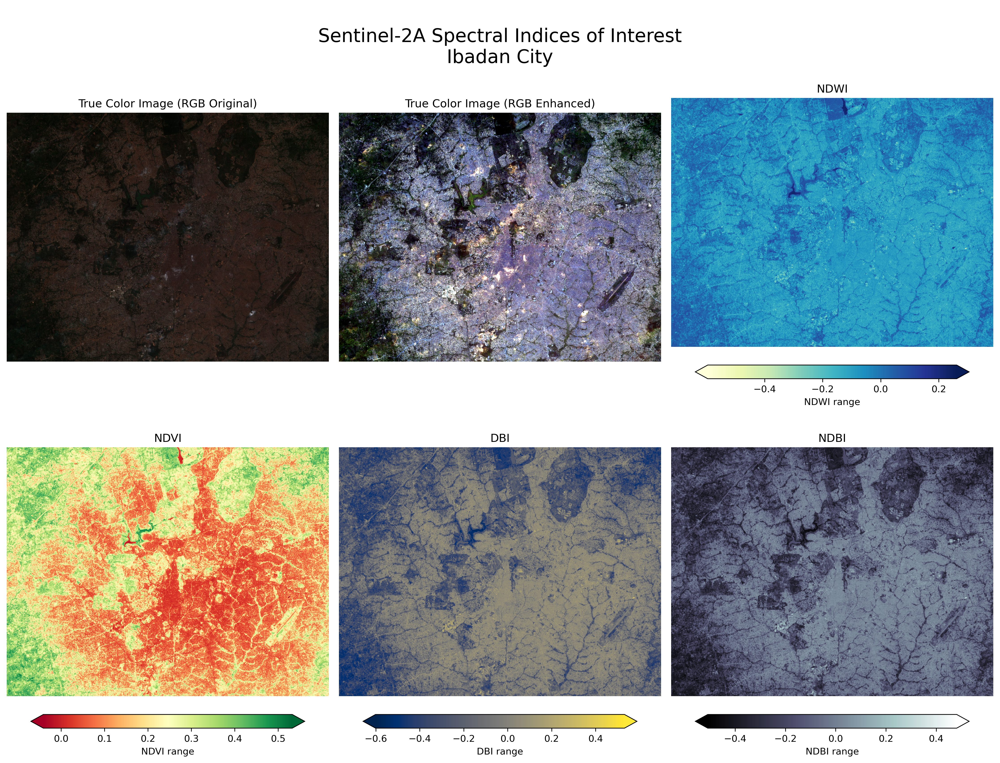

In [113]:
fig = plot_spectral_indices(input_file=filename)

In [3]:
from geotile import GeoTile

In [54]:
filename = "../../../S2/Ibadan-shp_geojs/S2_ibadan_2022-09-01_2022-12-31_file4.tif"
raster = rio.open(filename)
gt_ibadan = GeoTile(filename)
gt_ibadan.meta

{'driver': 'GTiff',
 'dtype': 'float32',
 'nodata': None,
 'width': 2779,
 'height': 2148,
 'count': 11,
 'crs': CRS.from_epsg(4326),
 'transform': Affine(8.983152841195215e-05, 0.0, 3.761785083778908,
        0.0, -8.983152841195215e-05, 7.498058013488822)}

In [55]:
raster.meta

{'driver': 'GTiff',
 'dtype': 'float32',
 'nodata': None,
 'width': 2779,
 'height': 2148,
 'count': 11,
 'crs': CRS.from_epsg(4326),
 'transform': Affine(8.983152841195215e-05, 0.0, 3.761785083778908,
        0.0, -8.983152841195215e-05, 7.498058013488822)}

In [56]:
### Generate aand save the tiles
out_dir = "../../../S2/Ibadan-shp_geojs/geotiles/"
gt_ibadan.generate_tiles(save_tiles=False, save_transform=True, tile_x=512, tile_y=512, stride_x=512, stride_y=512)
gt_ibadan.convert_nan_to_zero()
gt_ibadan.drop_nan_tiles()
gt_ibadan.drop_zero_value_tiles()
# gt_ibadan.save_tiles(output_folder=out_dir, suffix="s2ib_f4")
gt_ibadan.meta

{'driver': 'GTiff',
 'dtype': 'float32',
 'nodata': None,
 'width': 2779,
 'height': 2148,
 'count': 11,
 'crs': CRS.from_epsg(4326),
 'transform': Affine(8.983152841195215e-05, 0.0, 3.761785083778908,
        0.0, -8.983152841195215e-05, 7.498058013488822)}

In [57]:
geo_data = gt_ibadan.tile_data
print(geo_data.shape)
### Change the axis from (band, x, y) to (x, y, band)
# geo_data = np.transpose(geo_data, (1, 2, 0))
print(geo_data.shape)

(30, 512, 512, 11)
(30, 512, 512, 11)


In [58]:
raster.read().shape

(11, 2148, 2779)

In [72]:
### Sentinel 2 image processing level 1
def enhance_s2_rgb(raster):
    # Read the data
    data = raster.read()

    ### Change the axis from (band, x, y) to (x, y, band)
    data = np.transpose(data, (1, 2, 0))

    ## Preprocessing
    data_enhanced = np.zeros(data.shape)
    for i in range(data.shape[-1]):
        p2, p98 = np.percentile(data[:, :, i], (2, 98))
        data_enhanced[:, :, i] = exposure.rescale_intensity(data[:, :, i], in_range=(p2, p98))

    return data, data_enhanced


def geo_enhance_s2_rgb(geo_data):
    ## Preprocessing
    geo_enhanced = np.zeros(geo_data.shape)
    for i in range(geo_data.shape[-1]):
        for j in range(geo_data.shape[0]):
            p1, p99 = np.percentile(geo_data[j, :, :, i], (1, 99))
            geo_enhanced[j, :, :, i] = exposure.rescale_intensity(geo_data[j, :, :, i], in_range=(p1, p99))

    return geo_data, geo_enhanced

In [73]:
### Process Geo-raster 
geo_data, geo_enhanced = geo_enhance_s2_rgb(geo_data)


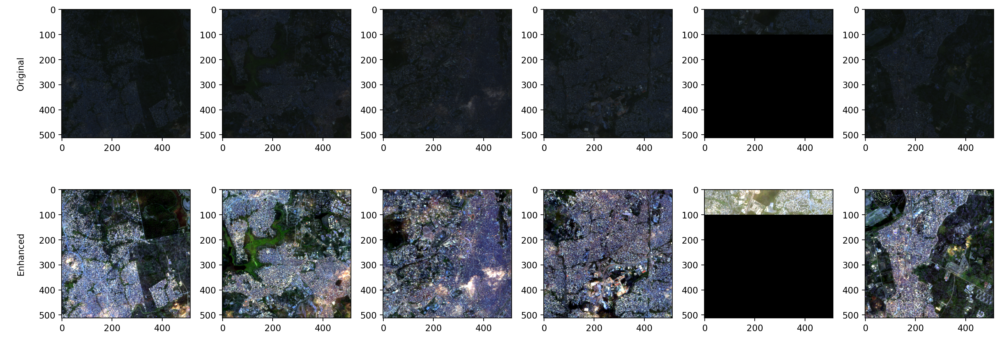

In [79]:
### Plot imagery
fig, ax = plt.subplots(2, 6, figsize=(16, 6), dpi=200)

# fig.suptitle("\nRGB tiles", y=0.95)
ax[0,0].set_ylabel("\nOriginal\n")
ax[1,0].set_ylabel("\nEnhanced\n")
for j in range(6):
    ax[0, j].imshow(geo_data[j+10, :, :, 0:3], cmap="terrain")
    ax[1, j].imshow(geo_enhanced[j+10, :, :, 0:3], cmap="terrain")
    
fig.tight_layout();

## Important Archive

### Updating a subset of raster values

Consider having a source raster data set (`.tif` file) and a number of polygon features. For each one of those polygons you need to:
1. 'clip' the raster.
2. change values of those clipped raster cells (with the average value).
3. write new values back to the source raster.

Two ways of achieving this are proposoed below.

#### Using `rioxarray`

```python
import numpy
import rioxarray
from shapely.geometry import mapping

xds = rioxarray.open_rasterio("NI_RIVER_ALR_1000.tif").sel(band=1).squeeze()
gdb_vml_polygs = 'RSA_VML_BUILDINGS_NI.gdb'
fc_vml_polygs = 'VML_Buildings_NI'
vml_polygs = gpd.read_file(gdb_vml_polygs, driver='FileGDB', layer=fc_vml_polygs)
out_xds = xds.copy()
for geom in vml_polygs.geometry.apply(mapping):
    clipped = xds.rio.clip([geom], vml_polygs.crs, drop=False)
    out_xds = out_xds.where(numpy.isnan(clipped), clipped.mean())
out_xds.rio.to_raster("out_averages.tif")
```

#### Using `rasterio`

```python
filled=False gives back masked array which can be utilised to replace with mean value.

Make sure to set crop=False and set the indexes to the band you want to replace it with.

import geopandas as gpd
import rasterio.mask
import rasterio as rio

gdf = gpd.read_file('input_shp.shp')

with rio.open("input.tif", "r") as src:
    band_num = 1
    src_image = src.read(band_num, out_dtype=rio.float64)

    # for each feature geom, replace with mean
    for geom in gdf.geometry:
        out_image, out_transform = rio.mask.mask(
            src, [geom], crop=False, filled=False, indexes=band_num
        )
        src_image[~out_image.mask] = src_image[~out_image.mask].mean()
    
    # save tif
    profile = src.profile
    profile.update(dtype=rio.float64, count=1, compress="lzw")

    with rasterio.open("output.tif", "w", **profile) as dst:
        dst.write(src_image, 1)
```

In [ ]:
from sentinelsat import SentinelAPI, read_geojson, geojson_to_wkt

api = SentinelAPI('user', 'password')
footprint = geojson_to_wkt(read_geojson('search_polygon.geojson'))
products = api.query(footprint,
                     producttype='SLC',
                     orbitdirection='ASCENDING',
                     limit=10)
api.download_all(products)

In [100]:
fname = "../data-in/nga-osm/nigeria-latest-free.shp/gis_osm_roads_free_1.shp"
osm_roads = gpd.read_file(fname)
osm_roads.head()

,osm_id,code,fclass,name,ref,oneway,maxspeed,layer,bridge,tunnel,geometry
0,4844937,5121,unclassified,None,None,B,0,0,F,F,"LINESTRING (7.48563 9.04834, 7.48522 9.04900, ..."
1,4844938,5113,primary,Bill Clinton Drive,None,F,50,0,F,F,"LINESTRING (7.24687 8.96567, 7.24770 8.96672, ..."
2,4844939,5113,primary,None,None,F,0,0,F,F,"LINESTRING (7.27016 9.00624, 7.27017 9.00614, ..."
3,4844940,5141,service,None,None,F,0,0,F,F,"LINESTRING (7.48510 9.04918, 7.48522 9.04925, ..."
4,4863116,5113,primary,None,None,F,0,0,F,F,"LINESTRING (7.49996 9.06574, 7.50003 9.06597, ..."
